In [313]:
%matplotlib inline
import math
import numpy as np
import pandas as pd
import scipy.stats as stats
import matplotlib.pyplot as plt

from collections import defaultdict
from scipy.stats.stats import pearsonr

df = pd.read_csv('Training_DU.csv')

In [314]:
testfinale = pd.read_csv('Test_DU.csv')

In [315]:
df

,PurchDate,Model,SubModel,VehYear,RefId,IsBadBuy,Auction,VehicleAge,Make,Engine,...,Size,TopThreeAmericanName,MMRAcquisitionAuctionAveragePrice,BYRNO,VNZIP1,VNST,VehBCost,IsOnlineSale,WarrantyCost,Doors
0,2009-01-04,1500 RAM,QUAD CAB,2002,62472,0,ADESA,7,DODGE,5.9L,...,LARGE TRUCK,CHRYSLER,5872.0,20234,85226,AZ,7940.0,0,1125,NaN
1,2009-01-04,1500 RAM,QUAD CAB,2003,16342,0,MANHEIM,6,DODGE,5.7L,...,LARGE TRUCK,CHRYSLER,7648.0,19619,32824,FL,9400.0,0,1220,NaN
2,2009-01-04,1500 RAM,QUAD CAB,2005,16344,0,MANHEIM,4,DODGE,5.7L,...,LARGE TRUCK,CHRYSLER,10306.0,19619,32824,FL,10000.0,0,920,NaN
3,2009-01-04,300,SEDAN,2006,62463,0,ADESA,3,CHRYSLER,2.7L MPI,...,SPECIALTY,CHRYSLER,9459.0,20234,85226,AZ,9505.0,0,1389,4D
4,2009-01-04,300,SEDAN,2006,20574,0,MANHEIM,3,CHRYSLER,2.7L MPI,...,SPECIALTY,CHRYSLER,9459.0,20833,75236,TX,10050.0,0,1215,4D
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
50901,2010-12-30,GRAND VITARA,UTILITY SPORT,2006,68096,1,ADESA,4,SUZUKI,NaN,...,MEDIUM SUV,OTHER,7057.0,52598,28273,NC,7470.0,0,920,4D
50902,2010-12-30,MALIBU,SEDAN,2005,60722,1,MANHEIM,5,CHEVROLET,4C,...,MEDIUM,GM,3806.0,21047,92337,CA,4395.0,0,1243,4D
50903,2010-12-30,SPECTRA,SEDAN,2006,70450,0,ADESA,4,KIA,NaN,...,MEDIUM,OTHER,4894.0,20740,32219,FL,5350.0,0,482,4D
50904,2010-12-30,TAURUS,SEDAN,2006,68098,0,ADESA,4,FORD,NaN,...,MEDIUM,FORD,3964.0,52598,28273,NC,5145.0,0,825,4D


In [316]:
df.isnull().sum()

PurchDate                                0
Model                                    0
SubModel                                 0
VehYear                                  0
RefId                                    0
IsBadBuy                                 0
Auction                                  0
VehicleAge                               0
Make                                     0
Engine                               17828
Trim                                     0
Transmission                             0
WheelTypeID                              0
VehOdo                                   0
Nationality                              0
Size                                     0
TopThreeAmericanName                     0
MMRAcquisitionAuctionAveragePrice        0
BYRNO                                    0
VNZIP1                                   0
VNST                                     0
VehBCost                                 0
IsOnlineSale                             0
WarrantyCos

In [317]:
testfinale.isnull().sum()

RefId                                   0
IsBadBuy                                0
PurchDate                               0
Auction                                 0
VehYear                                 0
VehicleAge                              0
Make                                    0
Engine                               4883
Trim                                  430
Transmission                            1
WheelTypeID                           596
VehOdo                                  0
Nationality                             1
Size                                    1
TopThreeAmericanName                    1
MMRAcquisitionAuctionAveragePrice       5
MMRAcquisitionAuctionCleanPrice         5
MMRAcquisitionRetailAveragePrice        5
MMRAcquisitonRetailCleanPrice           5
MMRCurrentAuctionAveragePrice          70
MMRCurrentAuctionCleanPrice            70
MMRCurrentRetailAveragePrice           70
MMRCurrentRetailCleanPrice             70
BYRNO                             

In [318]:
column2drop = ['Engine', 'Doors', 'RefId', 'MMRAcquisitionAuctionCleanPrice', 'MMRAcquisitonRetailCleanPrice', 'MMRCurrentAuctionAveragePrice', 'MMRCurrentAuctionCleanPrice', 'MMRCurrentRetailAveragePrice', 'MMRAcquisitionRetailAveragePrice',  'MMRCurrentRetailCleanPrice']
testfinale.drop(column2drop, axis=1, inplace=True)

In [319]:
column2drop = ['Engine', 'Doors', 'RefId']
df.drop(column2drop, axis=1, inplace=True)

In [320]:
df['PurchDate'] = pd.to_datetime(df['PurchDate']).dt.to_period('M')
df['PurchDate']

0        2009-01
1        2009-01
2        2009-01
3        2009-01
4        2009-01
          ...   
50901    2010-12
50902    2010-12
50903    2010-12
50904    2010-12
50905    2010-12
Name: PurchDate, Length: 50906, dtype: period[M]

In [321]:
testfinale['PurchDate'] = pd.to_datetime(testfinale['PurchDate']).dt.to_period('M')
testfinale['PurchDate']

0        2010-10
1        2010-01
2        2009-09
3        2010-01
4        2009-03
          ...   
14592    2009-09
14593    2010-08
14594    2009-07
14595    2009-06
14596    2009-11
Name: PurchDate, Length: 14597, dtype: period[M]

In [322]:
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder

In [323]:
testfinale.isnull().sum()

IsBadBuy                               0
PurchDate                              0
Auction                                0
VehYear                                0
VehicleAge                             0
Make                                   0
Trim                                 430
Transmission                           1
WheelTypeID                          596
VehOdo                                 0
Nationality                            1
Size                                   1
TopThreeAmericanName                   1
MMRAcquisitionAuctionAveragePrice      5
BYRNO                                  0
VNZIP1                                 0
VNST                                   0
VehBCost                               0
IsOnlineSale                           0
WarrantyCost                           0
Model                                  0
SubModel                               1
dtype: int64

In [324]:
df

,PurchDate,Model,SubModel,VehYear,IsBadBuy,Auction,VehicleAge,Make,Trim,Transmission,...,Nationality,Size,TopThreeAmericanName,MMRAcquisitionAuctionAveragePrice,BYRNO,VNZIP1,VNST,VehBCost,IsOnlineSale,WarrantyCost
0,2009-01,1500 RAM,QUAD CAB,2002,0,ADESA,7,DODGE,ST,AUTO,...,AMERICAN,LARGE TRUCK,CHRYSLER,5872.0,20234,85226,AZ,7940.0,0,1125
1,2009-01,1500 RAM,QUAD CAB,2003,0,MANHEIM,6,DODGE,LAR,AUTO,...,AMERICAN,LARGE TRUCK,CHRYSLER,7648.0,19619,32824,FL,9400.0,0,1220
2,2009-01,1500 RAM,QUAD CAB,2005,0,MANHEIM,4,DODGE,SLT,AUTO,...,AMERICAN,LARGE TRUCK,CHRYSLER,10306.0,19619,32824,FL,10000.0,0,920
3,2009-01,300,SEDAN,2006,0,ADESA,3,CHRYSLER,BAS,AUTO,...,AMERICAN,SPECIALTY,CHRYSLER,9459.0,20234,85226,AZ,9505.0,0,1389
4,2009-01,300,SEDAN,2006,0,MANHEIM,3,CHRYSLER,BAS,AUTO,...,AMERICAN,SPECIALTY,CHRYSLER,9459.0,20833,75236,TX,10050.0,0,1215
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
50901,2010-12,GRAND VITARA,UTILITY SPORT,2006,1,ADESA,4,SUZUKI,BAS,AUTO,...,NOT AMERICAN,MEDIUM SUV,OTHER,7057.0,52598,28273,NC,7470.0,0,920
50902,2010-12,MALIBU,SEDAN,2005,1,MANHEIM,5,CHEVROLET,CLA,AUTO,...,AMERICAN,MEDIUM,GM,3806.0,21047,92337,CA,4395.0,0,1243
50903,2010-12,SPECTRA,SEDAN,2006,0,ADESA,4,KIA,EX,AUTO,...,NOT AMERICAN,MEDIUM,OTHER,4894.0,20740,32219,FL,5350.0,0,482
50904,2010-12,TAURUS,SEDAN,2006,0,ADESA,4,FORD,SE,AUTO,...,AMERICAN,MEDIUM,FORD,3964.0,52598,28273,NC,5145.0,0,825


In [325]:
testfinale

,IsBadBuy,PurchDate,Auction,VehYear,VehicleAge,Make,Trim,Transmission,WheelTypeID,VehOdo,...,TopThreeAmericanName,MMRAcquisitionAuctionAveragePrice,BYRNO,VNZIP1,VNST,VehBCost,IsOnlineSale,WarrantyCost,Model,SubModel
0,0,2010-10,MANHEIM,2003,7,CHEVROLET,150,AUTO,1.0,71991,...,GM,8252.0,835,85040,AZ,11390.0,0,1572,AVALANCHE,SUV-PICKUP
1,0,2010-01,OTHER,2006,4,FORD,BAS,MANUAL,1.0,73815,...,FORD,8840.0,17675,27407,NC,7700.0,0,803,MUSTANG,COUPE
2,0,2009-09,MANHEIM,2004,5,DODGE,ES,AUTO,1.0,74213,...,CHRYSLER,2852.0,99740,85040,AZ,5700.0,0,1389,STRATUS,SEDAN
3,0,2010-01,OTHER,2004,6,HYUNDAI,BAS,MANUAL,1.0,77980,...,OTHER,4054.0,3453,80229,CO,5155.0,0,920,TIBURON,COUPE
4,0,2009-03,MANHEIM,2004,5,CHEVROLET,NOR,AUTO,1.0,77819,...,GM,6543.0,22916,80011,CO,6785.0,0,1155,TRAILBLAZER,SUV
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14592,1,2009-09,MANHEIM,2004,5,FORD,BAS,AUTO,3.0,78065,...,FORD,6807.0,22916,80022,CO,7630.0,0,803,MUSTANG,CONVERTIBLE
14593,0,2010-08,OTHER,2006,4,CHEVROLET,LT,AUTO,2.0,72807,...,GM,7174.0,99750,95673,CA,6400.0,0,1038,MALIBU,SEDAN
14594,0,2009-07,ADESA,2004,5,KIA,EX,AUTO,1.0,80293,...,OTHER,2814.0,21053,85226,AZ,5350.0,0,853,OPTIMA,SEDAN
14595,0,2009-06,ADESA,2005,4,KIA,NaN,AUTO,1.0,54865,...,OTHER,7437.0,17675,28273,NC,7245.0,0,1003,AMANTI,SEDAN


In [331]:
testfinale.isnull().sum()

IsBadBuy                               0
PurchDate                              0
Auction                                0
VehYear                                0
VehicleAge                             0
Make                                   0
Trim                                 430
Transmission                           1
WheelTypeID                          596
VehOdo                                 0
Nationality                            1
Size                                   1
TopThreeAmericanName                   1
MMRAcquisitionAuctionAveragePrice      5
BYRNO                                  0
VNZIP1                                 0
VNST                                   0
VehBCost                               0
IsOnlineSale                           0
WarrantyCost                           0
Model                                  0
SubModel                               1
dtype: int64

In [332]:
testfinale['SubModel'] = testfinale['SubModel'].groupby([testfinale['Model'], testfinale['VehYear']]).fillna(testfinale['SubModel'].mode()[0])

In [333]:
testfinale['Trim'] = testfinale['Trim'].groupby([testfinale['Model'], testfinale['SubModel'], testfinale['VehYear']]).fillna(testfinale['Trim'].mode()[0])

In [334]:
testfinale['Transmission'] = testfinale['Transmission'].groupby([testfinale['Model'], testfinale['SubModel'], testfinale['VehYear']]).fillna(completo['Transmission'].mode()[0])

In [335]:
testfinale['WheelTypeID'] = testfinale['WheelTypeID'].groupby([testfinale['Model'], testfinale['SubModel'], testfinale['Trim']]).fillna(completo['WheelTypeID'].mode()[0])

In [336]:
testfinale['Nationality'] = testfinale['Nationality'].groupby([testfinale['Make']]).fillna(testfinale['Nationality'].mode()[0])

In [337]:
testfinale['Size'] = testfinale['Size'].groupby([testfinale['Model'], testfinale['SubModel'], testfinale['VehYear']]).fillna(testfinale['Size'].mode()[0])

In [338]:
testfinale['TopThreeAmericanName'] = testfinale['TopThreeAmericanName'].groupby([testfinale['Make']]).fillna(testfinale['Nationality'].mode()[0])

In [339]:
def fun_temp(x):
    return x.fillna(x.mean())

In [340]:
testfinale['MMRAcquisitionAuctionAveragePrice'] = testfinale['MMRAcquisitionAuctionAveragePrice'].groupby([testfinale['Model'], testfinale['SubModel'], testfinale['VehYear']]).apply(fun_temp)

In [341]:
completo = pd.concat([df, testfinale])

C:\Users\marco\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  """Entry point for launching an IPython kernel.


In [342]:
completo

,Auction,BYRNO,IsBadBuy,IsOnlineSale,MMRAcquisitionAuctionAveragePrice,Make,Model,Nationality,PurchDate,Size,...,Transmission,Trim,VNST,VNZIP1,VehBCost,VehOdo,VehYear,VehicleAge,WarrantyCost,WheelTypeID
0,ADESA,20234,0,0,5872.0,DODGE,1500 RAM,AMERICAN,2009-01,LARGE TRUCK,...,AUTO,ST,AZ,85226,7940.0,62209,2002,7,1125,1.0
1,MANHEIM,19619,0,0,7648.0,DODGE,1500 RAM,AMERICAN,2009-01,LARGE TRUCK,...,AUTO,LAR,FL,32824,9400.0,79925,2003,6,1220,1.0
2,MANHEIM,19619,0,0,10306.0,DODGE,1500 RAM,AMERICAN,2009-01,LARGE TRUCK,...,AUTO,SLT,FL,32824,10000.0,78806,2005,4,920,2.0
3,ADESA,20234,0,0,9459.0,CHRYSLER,300,AMERICAN,2009-01,SPECIALTY,...,AUTO,BAS,AZ,85226,9505.0,71624,2006,3,1389,2.0
4,MANHEIM,20833,0,0,9459.0,CHRYSLER,300,AMERICAN,2009-01,SPECIALTY,...,AUTO,BAS,TX,75236,10050.0,64278,2006,3,1215,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14592,MANHEIM,22916,1,0,6807.0,FORD,MUSTANG,AMERICAN,2009-09,SPORTS,...,AUTO,BAS,CO,80022,7630.0,78065,2004,5,803,3.0
14593,OTHER,99750,0,0,7174.0,CHEVROLET,MALIBU,AMERICAN,2010-08,MEDIUM,...,AUTO,LT,CA,95673,6400.0,72807,2006,4,1038,2.0
14594,ADESA,21053,0,0,2814.0,KIA,OPTIMA,NOT AMERICAN,2009-07,MEDIUM,...,AUTO,EX,AZ,85226,5350.0,80293,2004,5,853,1.0
14595,ADESA,17675,0,0,7437.0,KIA,AMANTI,NOT AMERICAN,2009-06,LARGE,...,AUTO,BAS,NC,28273,7245.0,54865,2005,4,1003,1.0


In [343]:
label_encoders = dict()
column2encode = ['Trim', 'Transmission','Nationality' ]
for col in column2encode:
    le = LabelEncoder()
    completo[col] = le.fit_transform(completo[col])
    label_encoders[col] = le

In [344]:
label_encoders = dict()
column2encode = ['PurchDate', 'Auction', 'Make', 'Size', 'BYRNO', 'VNZIP1', 'VNST', 'Model', 'SubModel', 'TopThreeAmericanName']
for col in column2encode:
    le = LabelEncoder()
    integer =  le.fit_transform(completo[col])
    #print(integer)
    max = np.amax(integer)
    integer = integer.reshape(len(completo[col]), 1)
    #print(integer)
    print(col)
    print(max)
    oh = OneHotEncoder(sparse = False)
    oh = oh.fit_transform(integer)
    for i in range(0, max+1):
        completo[col+str(i)] = oh[:, i]
    completo.drop(col, axis=1, inplace=True)

PurchDate
23
Auction
2
Make
31


C:\Users\marco\Anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:415: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
C:\Users\marco\Anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:415: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you us

Size
11
BYRNO
73


C:\Users\marco\Anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:415: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)
C:\Users\marco\Anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:415: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you us

VNZIP1
152


C:\Users\marco\Anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:415: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)


VNST
36


C:\Users\marco\Anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:415: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)


Model
265


C:\Users\marco\Anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:415: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)


SubModel
37


C:\Users\marco\Anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:415: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)


TopThreeAmericanName
4


C:\Users\marco\Anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:415: FutureWarning: The handling of integer data will change in version 0.22. Currently, the categories are determined based on the range [0, max(values)], while in the future they will be determined based on the unique values.
If you want the future behaviour and silence this warning, you can specify "categories='auto'".
In case you used a LabelEncoder before this OneHotEncoder to convert the categories to integers, then you can now use the OneHotEncoder directly.
  warnings.warn(msg, FutureWarning)


In [345]:
completo

,IsBadBuy,IsOnlineSale,MMRAcquisitionAuctionAveragePrice,Nationality,Transmission,Trim,VehBCost,VehOdo,VehYear,VehicleAge,...,SubModel33,SubModel34,SubModel35,SubModel36,SubModel37,TopThreeAmericanName0,TopThreeAmericanName1,TopThreeAmericanName2,TopThreeAmericanName3,TopThreeAmericanName4
0,0,0,5872.0,0,0,100,7940.0,62209,2002,7,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
1,0,0,7648.0,0,0,55,9400.0,79925,2003,6,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
2,0,0,10306.0,0,0,94,10000.0,78806,2005,4,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
3,0,0,9459.0,0,0,7,9505.0,71624,2006,3,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
4,0,0,9459.0,0,0,7,10050.0,64278,2006,3,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14592,1,0,6807.0,0,0,7,7630.0,78065,2004,5,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
14593,0,0,7174.0,0,0,60,6400.0,72807,2006,4,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
14594,0,0,2814.0,1,0,28,5350.0,80293,2004,5,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
14595,0,0,7437.0,1,0,7,7245.0,54865,2005,4,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


In [350]:
completo['CostOverOdo'] = completo['VehBCost'] / completo['VehOdo']

In [359]:
df = completo.iloc[:50906, :50906]

In [358]:
testfinale = completo.iloc[50906:, :]

In [361]:
df

,IsBadBuy,IsOnlineSale,MMRAcquisitionAuctionAveragePrice,Nationality,Transmission,Trim,VehBCost,VehOdo,VehYear,VehicleAge,...,SubModel34,SubModel35,SubModel36,SubModel37,TopThreeAmericanName0,TopThreeAmericanName1,TopThreeAmericanName2,TopThreeAmericanName3,TopThreeAmericanName4,CostOverOdo
0,0,0,5872.0,0,0,100,7940.0,62209,2002,7,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.127634
1,0,0,7648.0,0,0,55,9400.0,79925,2003,6,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.117610
2,0,0,10306.0,0,0,94,10000.0,78806,2005,4,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.126894
3,0,0,9459.0,0,0,7,9505.0,71624,2006,3,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.132707
4,0,0,9459.0,0,0,7,10050.0,64278,2006,3,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.156352
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
50901,1,0,7057.0,1,0,7,7470.0,55109,2006,4,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.135550
50902,1,0,3806.0,0,0,12,4395.0,80072,2005,5,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.054888
50903,0,0,4894.0,1,0,28,5350.0,43116,2006,4,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.124084
50904,0,0,3964.0,0,0,84,5145.0,69853,2006,4,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.073655


In [201]:
from sklearn.model_selection import train_test_split

In [403]:
attributes = [col for col in df.columns if col != 'IsBadBuy']
X = df[attributes].values
y = df['IsBadBuy']

X_train, X_test, y_train, y_test = train_test_split(X, y, 
                                                    test_size=0.3, 
                                                    random_state=100, 
                                                    stratify=y)

In [404]:
 X_train.shape, X_test.shape

((35634, 656), (15272, 656))

In [364]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import recall_score
from sklearn.metrics import make_scorer

In [365]:
def report(results, n_top):
    for i in range(1, n_top + 1):
        candidates = np.flatnonzero(results['rank_test_score'] == i)
        for candidate in candidates:
            print("Model with rank: {0}".format(i))
            print("Mean validation score: {0:.3f} (std: {1:.3f})".format(
                  results['mean_test_score'][candidate],
                  results['std_test_score'][candidate]))
            print("Parameters: {0}".format(results['params'][candidate]))
            print("")

In [487]:
param_list = {'max_depth': [None], #+ list(np.arange(1000, 100000)),
              'min_samples_split': [2, 5, 10, 15, 20, 50, 100, 150, 200, 500],
              'min_samples_leaf': [1,2, 3, 4, 5, 6, 7, 8, 9, 10, 20, 30, 50, 100],
             }

clf = DecisionTreeClassifier(criterion='gini', max_depth=None, min_samples_split=2, min_samples_leaf=1)
#clf.fit(X, y)
#print(classification_report(y_test, y_pred))
random_search = RandomizedSearchCV(clf, scoring = make_scorer(recall_score) ,param_distributions=param_list, n_iter=100)
random_search.fit(X, y)


#report(f1_score(X, y, average=None), n_top=3)
report(random_search.cv_results_, n_top=10)

C:\Users\marco\Anaconda3\lib\site-packages\sklearn\model_selection\_split.py:1978: FutureWarning: The default value of cv will change from 3 to 5 in version 0.22. Specify it explicitly to silence this warning.
  warnings.warn(CV_WARNING, FutureWarning)


Model with rank: 1
Mean validation score: 0.178 (std: 0.011)
Parameters: {'min_samples_split': 2, 'min_samples_leaf': 1, 'max_depth': None}

Model with rank: 2
Mean validation score: 0.167 (std: 0.012)
Parameters: {'min_samples_split': 5, 'min_samples_leaf': 3, 'max_depth': None}

Model with rank: 3
Mean validation score: 0.166 (std: 0.012)
Parameters: {'min_samples_split': 5, 'min_samples_leaf': 1, 'max_depth': None}

Model with rank: 4
Mean validation score: 0.164 (std: 0.016)
Parameters: {'min_samples_split': 2, 'min_samples_leaf': 3, 'max_depth': None}

Model with rank: 5
Mean validation score: 0.162 (std: 0.010)
Parameters: {'min_samples_split': 10, 'min_samples_leaf': 1, 'max_depth': None}

Model with rank: 6
Mean validation score: 0.154 (std: 0.009)
Parameters: {'min_samples_split': 2, 'min_samples_leaf': 5, 'max_depth': None}

Model with rank: 7
Mean validation score: 0.154 (std: 0.010)
Parameters: {'min_samples_split': 10, 'min_samples_leaf': 5, 'max_depth': None}

Model with 

In [ ]:
ENTROPIA

Model with rank: 1
Mean validation score: 0.193 (std: 0.001)
Parameters: {'min_samples_split': 2, 'min_samples_leaf': 3, 'max_depth': None}

Model with rank: 2
Mean validation score: 0.192 (std: 0.012)
Parameters: {'min_samples_split': 2, 'min_samples_leaf': 1, 'max_depth': None}

Model with rank: 3
Mean validation score: 0.190 (std: 0.002)
Parameters: {'min_samples_split': 5, 'min_samples_leaf': 3, 'max_depth': None}

Model with rank: 4
Mean validation score: 0.187 (std: 0.007)
Parameters: {'min_samples_split': 10, 'min_samples_leaf': 1, 'max_depth': None}

Model with rank: 5
Mean validation score: 0.185 (std: 0.005)
Parameters: {'min_samples_split': 10, 'min_samples_leaf': 3, 'max_depth': None}

Model with rank: 6
Mean validation score: 0.179 (std: 0.008)
Parameters: {'min_samples_split': 15, 'min_samples_leaf': 5, 'max_depth': None}

Model with rank: 7
Mean validation score: 0.179 (std: 0.006)
Parameters: {'min_samples_split': 5, 'min_samples_leaf': 4, 'max_depth': None}

Model with rank: 8
Mean validation score: 0.179 (std: 0.007)
Parameters: {'min_samples_split': 5, 'min_samples_leaf': 5, 'max_depth': None}

Model with rank: 9
Mean validation score: 0.178 (std: 0.006)
Parameters: {'min_samples_split': 2, 'min_samples_leaf': 5, 'max_depth': None}

Model with rank: 10
Mean validation score: 0.178 (std: 0.003)
Parameters: {'min_samples_split': 10, 'min_samples_leaf': 4, 'max_depth': None}



GINI

Model with rank: 1
Mean validation score: 0.178 (std: 0.011)
Parameters: {'min_samples_split': 2, 'min_samples_leaf': 1, 'max_depth': None}

Model with rank: 2
Mean validation score: 0.167 (std: 0.012)
Parameters: {'min_samples_split': 5, 'min_samples_leaf': 3, 'max_depth': None}

Model with rank: 3
Mean validation score: 0.166 (std: 0.012)
Parameters: {'min_samples_split': 5, 'min_samples_leaf': 1, 'max_depth': None}

Model with rank: 4
Mean validation score: 0.164 (std: 0.016)
Parameters: {'min_samples_split': 2, 'min_samples_leaf': 3, 'max_depth': None}

Model with rank: 5
Mean validation score: 0.162 (std: 0.010)
Parameters: {'min_samples_split': 10, 'min_samples_leaf': 1, 'max_depth': None}

Model with rank: 6
Mean validation score: 0.154 (std: 0.009)
Parameters: {'min_samples_split': 2, 'min_samples_leaf': 5, 'max_depth': None}

Model with rank: 7
Mean validation score: 0.154 (std: 0.010)
Parameters: {'min_samples_split': 10, 'min_samples_leaf': 5, 'max_depth': None}

Model with rank: 8
Mean validation score: 0.152 (std: 0.007)
Parameters: {'min_samples_split': 5, 'min_samples_leaf': 5, 'max_depth': None}

Model with rank: 9
Mean validation score: 0.150 (std: 0.013)
Parameters: {'min_samples_split': 15, 'min_samples_leaf': 1, 'max_depth': None}

Model with rank: 10
Mean validation score: 0.149 (std: 0.011)
Parameters: {'min_samples_split': 10, 'min_samples_leaf': 3, 'max_depth': None}

In [168]:
GINI maz 1 000 000

Model with rank: 1
Mean validation score: 0.184 (std: 0.012)
Parameters: {'min_samples_split': 2, 'min_samples_leaf': 1, 'max_depth': 26649}

Model with rank: 2
Mean validation score: 0.173 (std: 0.010)
Parameters: {'min_samples_split': 5, 'min_samples_leaf': 1, 'max_depth': 490831}

Model with rank: 3
Mean validation score: 0.168 (std: 0.013)
Parameters: {'min_samples_split': 5, 'min_samples_leaf': 1, 'max_depth': 935933}

Model with rank: 4
Mean validation score: 0.155 (std: 0.011)
Parameters: {'min_samples_split': 10, 'min_samples_leaf': 5, 'max_depth': 658285}

Model with rank: 5
Mean validation score: 0.153 (std: 0.009)
Parameters: {'min_samples_split': 5, 'min_samples_leaf': 5, 'max_depth': 296745}

Model with rank: 6
Mean validation score: 0.152 (std: 0.015)
Parameters: {'min_samples_split': 5, 'min_samples_leaf': 2, 'max_depth': 52401}

Model with rank: 7
Mean validation score: 0.150 (std: 0.015)
Parameters: {'min_samples_split': 15, 'min_samples_leaf': 1, 'max_depth': 281960}

    
max 100 000

Model with rank: 1
Mean validation score: 0.167 (std: 0.012)
Parameters: {'min_samples_split': 2, 'min_samples_leaf': 3, 'max_depth': 34400}

Model with rank: 2
Mean validation score: 0.166 (std: 0.012)
Parameters: {'min_samples_split': 2, 'min_samples_leaf': 3, 'max_depth': 88623}

Model with rank: 3
Mean validation score: 0.166 (std: 0.011)
Parameters: {'min_samples_split': 2, 'min_samples_leaf': 3, 'max_depth': 9178}

Model with rank: 4
Mean validation score: 0.166 (std: 0.014)
Parameters: {'min_samples_split': 5, 'min_samples_leaf': 3, 'max_depth': 87077}

Model with rank: 5
Mean validation score: 0.161 (std: 0.015)
Parameters: {'min_samples_split': 10, 'min_samples_leaf': 1, 'max_depth': 53410}

Model with rank: 6
Mean validation score: 0.159 (std: 0.015)
Parameters: {'min_samples_split': 10, 'min_samples_leaf': 1, 'max_depth': 97922}

Model with rank: 7
Mean validation score: 0.152 (std: 0.011)
Parameters: {'min_samples_split': 5, 'min_samples_leaf': 5, 'max_depth': 82495}

Model with rank: 8
Mean validation score: 0.151 (std: 0.008)
Parameters: {'min_samples_split': 5, 'min_samples_leaf': 5, 'max_depth': 90822}

ENTROPIA max 1 000 000

Model with rank: 1
Mean validation score: 0.184 (std: 0.007)
Parameters: {'min_samples_split': 5, 'min_samples_leaf': 5, 'max_depth': 742998}

Model with rank: 2
Mean validation score: 0.181 (std: 0.007)
Parameters: {'min_samples_split': 10, 'min_samples_leaf': 4, 'max_depth': 960937}

Model with rank: 3
Mean validation score: 0.178 (std: 0.004)
Parameters: {'min_samples_split': 5, 'min_samples_leaf': 4, 'max_depth': 295762}

Model with rank: 4
Mean validation score: 0.178 (std: 0.010)
Parameters: {'min_samples_split': 2, 'min_samples_leaf': 5, 'max_depth': 468846}

Model with rank: 5
Mean validation score: 0.177 (std: 0.002)
Parameters: {'min_samples_split': 15, 'min_samples_leaf': 4, 'max_depth': 418423}

Model with rank: 6
Mean validation score: 0.177 (std: 0.006)
Parameters: {'min_samples_split': 10, 'min_samples_leaf': 2, 'max_depth': 503855}

Model with rank: 7
Mean validation score: 0.176 (std: 0.004)
Parameters: {'min_samples_split': 5, 'min_samples_leaf': 4, 'max_depth': 250632}

Model with rank: 8
Mean validation score: 0.175 (std: 0.010)
Parameters: {'min_samples_split': 15, 'min_samples_leaf': 5, 'max_depth': 190059}

Model with rank: 9
Mean validation score: 0.175 (std: 0.008)
Parameters: {'min_samples_split': 15, 'min_samples_leaf': 1, 'max_depth': 592739}

Model with rank: 10
Mean validation score: 0.175 (std: 0.006)
Parameters: {'min_samples_split': 15, 'min_samples_leaf': 1, 'max_depth': 96130}

max 100 000

Model with rank: 1
Mean validation score: 0.191 (std: 0.006)
Parameters: {'min_samples_split': 2, 'min_samples_leaf': 3, 'max_depth': 32641}

Model with rank: 2
Mean validation score: 0.184 (std: 0.003)
Parameters: {'min_samples_split': 10, 'min_samples_leaf': 1, 'max_depth': 24261}

Model with rank: 3
Mean validation score: 0.184 (std: 0.003)
Parameters: {'min_samples_split': 10, 'min_samples_leaf': 1, 'max_depth': 35102}

Model with rank: 4
Mean validation score: 0.183 (std: 0.005)
Parameters: {'min_samples_split': 10, 'min_samples_leaf': 3, 'max_depth': 46542}

Model with rank: 5
Mean validation score: 0.180 (std: 0.002)
Parameters: {'min_samples_split': 5, 'min_samples_leaf': 5, 'max_depth': 74668}

Model with rank: 6
Mean validation score: 0.178 (std: 0.003)
Parameters: {'min_samples_split': 10, 'min_samples_leaf': 5, 'max_depth': 89034}

Model with rank: 7
Mean validation score: 0.177 (std: 0.005)
Parameters: {'min_samples_split': 15, 'min_samples_leaf': 1, 'max_depth': 8877}

Model with rank: 8
Mean validation score: 0.177 (std: 0.007)
Parameters: {'min_samples_split': 10, 'min_samples_leaf': 4, 'max_depth': 18292}

Model with rank: 9
Mean validation score: 0.177 (std: 0.005)
Parameters: {'min_samples_split': 15, 'min_samples_leaf': 4, 'max_depth': 20103}

Model with rank: 10
Mean validation score: 0.175 (std: 0.006)
Parameters: {'min_samples_split': 15, 'min_samples_leaf': 5, 'max_depth': 89750}


SyntaxError: invalid syntax (<ipython-input-168-168459c48441>, line 1)

In [488]:
clf = DecisionTreeClassifier(criterion='entropy', max_depth=None, min_samples_split=2, min_samples_leaf=3)
clf = clf.fit(X_train, y_train)

In [489]:
y_pred = clf.predict(X_test)
y_pred_tr = clf.predict(X_train)

In [368]:
for col, imp in zip(attributes, clf.feature_importances_):
    print(col, imp)
    

IsOnlineSale 0.0002447566346276594
MMRAcquisitionAuctionAveragePrice 0.08409835059654974
Nationality 0.001133167591818193
Transmission 0.002230298462038243
Trim 0.029591687574228236
VehBCost 0.0757101818837147
VehOdo 0.07698948749395311
VehYear 0.012391503106162627
VehicleAge 0.034132711163569425
WarrantyCost 0.03735993623796865
WheelTypeID 0.01423747614610488
PurchDate0 0.0028530833788942746
PurchDate1 0.003649959420064846
PurchDate2 0.004691749744379798
PurchDate3 0.003956809264793159
PurchDate4 0.0021140178606018746
PurchDate5 0.00298079832395019
PurchDate6 0.004208458479312408
PurchDate7 0.003400053532750686
PurchDate8 0.004374625046255557
PurchDate9 0.003076990032243833
PurchDate10 0.0057158425926768916
PurchDate11 0.0020704232185532554
PurchDate12 0.006075038490092437
PurchDate13 0.005970186571071556
PurchDate14 0.00786534904922345
PurchDate15 0.005318121774292589
PurchDate16 0.004947976804912871
PurchDate17 0.00776494475420698
PurchDate18 0.003686380112003086
PurchDate19 0.00345

In [14]:
import pydotplus
from sklearn import tree
from IPython.display import Image

In [93]:
dot_data = tree.export_graphviz(clf, out_file=None,  
                                feature_names=attributes, 
                                class_names=str(clf.classes_),  
                                filled=True, rounded=True,  
                                special_characters=True)  
graph = pydotplus.graph_from_dot_data(dot_data)  
Image(graph.create_png())

In [101]:
from sklearn.externals.six import StringIO  
from IPython.display import Image  
from sklearn.tree import export_graphviz
import pydotplus
dot_data = StringIO()
export_graphviz(clf, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True, feature_names = attributes,class_names=['0','1'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png('diabetes.png')
Image(graph.create_png())

In [22]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score, f1_score, classification_report
from sklearn.metrics import roc_curve, auc, roc_auc_score

In [490]:
print('Train Accuracy %s' % accuracy_score(y_train, y_pred_tr))
print('Train F1-score %s' % f1_score(y_train, y_pred_tr, average=None))
print()

print('Test Accuracy %s' % accuracy_score(y_test, y_pred))
print('Test F1-score %s' % f1_score(y_test, y_pred, average=None))
print(classification_report(y_test, y_pred))
confusion_matrix(y_test, y_pred)

Train Accuracy 0.9550990626929338
Train F1-score [0.97441392 0.81680788]

Test Accuracy 0.8046752226296491
Test F1-score [0.88844845 0.21561925]
              precision    recall  f1-score   support

           0       0.89      0.89      0.89     13359
           1       0.22      0.21      0.22      1913

    accuracy                           0.80     15272
   macro avg       0.55      0.55      0.55     15272
weighted avg       0.80      0.80      0.80     15272



array([[11879,  1480],
       [ 1503,   410]], dtype=int64)

In [370]:
fpr, tpr, _ = roc_curve(y_test, y_pred)
roc_auc = auc(fpr, tpr)
print(roc_auc)

roc_auc = roc_auc_score(y_test, y_pred, average=None)

0.5451291483444813


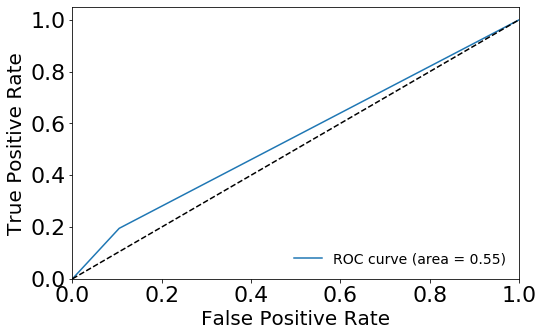

In [491]:
plt.figure(figsize=(8, 5))
plt.plot(fpr, tpr, label='ROC curve (area = %0.2f)' % (roc_auc))
    
plt.plot([0, 1], [0, 1], 'k--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate', fontsize=20)
plt.ylabel('True Positive Rate', fontsize=20) 
plt.tick_params(axis='both', which='major', labelsize=22)
plt.legend(loc="lower right", fontsize=14, frameon=False)
plt.show()

In [398]:
y_testfinale = testfinale.iloc[:, 0]

In [399]:
x_testfinale = testfinale.iloc[:, 1:]

In [400]:
y_predfinale = clf.predict(x_test)

In [492]:
print('Test finale Accuracy %s' % accuracy_score(y_testfinale, y_predfinale))
print('Test finale F1-score %s' % f1_score(y_testfinale, y_predfinale, average=None))
print(classification_report(y_testfinale, y_predfinale))
confusion_matrix(y_test, y_pred)

Test finale Accuracy 0.8056449955470302
Test finale F1-score [0.88927916 0.20554467]
              precision    recall  f1-score   support

           0       0.89      0.89      0.89     12829
           1       0.20      0.21      0.21      1768

    accuracy                           0.81     14597
   macro avg       0.55      0.55      0.55     14597
weighted avg       0.81      0.81      0.81     14597



array([[11879,  1480],
       [ 1503,   410]], dtype=int64)

In [90]:
from sklearn.model_selection import cross_val_score

In [91]:
scores = cross_val_score(clf, X, y, cv=10)
print('Accuracy: %0.4f (+/- %0.2f)' % (scores.mean(), scores.std() * 2))

scores = cross_val_score(clf, X, y, cv=10, scoring='f1_macro')
print('F1-score: %0.4f (+/- %0.2f)' % (scores.mean(), scores.std() * 2))

Accuracy: 0.6924 (+/- 0.24)
F1-score: 0.4932 (+/- 0.11)


In [408]:
y_predfinale = clf.predict(x_test)

In [409]:
print('Test finale Accuracy %s' % accuracy_score(y_testfinale, y_predfinale))
print('Test finale F1-score %s' % f1_score(y_testfinale, y_predfinale, average=None))
print(classification_report(y_testfinale, y_predfinale))
confusion_matrix(y_test, y_pred)

Test finale Accuracy 0.7963280126053298
Test finale F1-score [0.88363537 0.18436214]
              precision    recall  f1-score   support

           0       0.89      0.88      0.88     12829
           1       0.18      0.19      0.18      1768

    accuracy                           0.80     14597
   macro avg       0.53      0.53      0.53     14597
weighted avg       0.80      0.80      0.80     14597



array([[11865,  1494],
       [ 1522,   391]], dtype=int64)

In [505]:
clf = DecisionTreeClassifier(criterion='entropy', max_depth=None, min_samples_split=2, min_samples_leaf=1)
clf = clf.fit(X_train, y_train)

In [506]:
y_pred = clf.predict(X_test)
y_pred_tr = clf.predict(X_train)

In [507]:
print('Train Accuracy %s' % accuracy_score(y_train, y_pred_tr))
print('Train F1-score %s' % f1_score(y_train, y_pred_tr, average=None))
print()

print('Test Accuracy %s' % accuracy_score(y_test, y_pred))
print('Test F1-score %s' % f1_score(y_test, y_pred, average=None))
print(classification_report(y_test, y_pred))
confusion_matrix(y_test, y_pred)

Train Accuracy 1.0
Train F1-score [1. 1.]

Test Accuracy 0.803234677841802
Test F1-score [0.88755005 0.21355666]
              precision    recall  f1-score   support

           0       0.89      0.89      0.89     13359
           1       0.21      0.21      0.21      1913

    accuracy                           0.80     15272
   macro avg       0.55      0.55      0.55     15272
weighted avg       0.80      0.80      0.80     15272



array([[11859,  1500],
       [ 1505,   408]], dtype=int64)

In [508]:
y_predfinale = clf.predict(x_test)

In [509]:
print('Test finale Accuracy %s' % accuracy_score(y_testfinale, y_predfinale))
print('Test finale F1-score %s' % f1_score(y_testfinale, y_predfinale, average=None))
print(classification_report(y_testfinale, y_predfinale))
confusion_matrix(y_test, y_pred)

Test finale Accuracy 0.8007809823936425
Test finale F1-score [0.88612155 0.20503007]
              precision    recall  f1-score   support

           0       0.89      0.88      0.89     12829
           1       0.20      0.21      0.21      1768

    accuracy                           0.80     14597
   macro avg       0.54      0.55      0.55     14597
weighted avg       0.81      0.80      0.80     14597



array([[11859,  1500],
       [ 1505,   408]], dtype=int64)

In [510]:
clf = DecisionTreeClassifier(criterion='entropy', max_depth=None, min_samples_split=5, min_samples_leaf=3)
clf = clf.fit(X_train, y_train)

In [511]:
y_pred = clf.predict(X_test)
y_pred_tr = clf.predict(X_train)

In [512]:
print('Train Accuracy %s' % accuracy_score(y_train, y_pred_tr))
print('Train F1-score %s' % f1_score(y_train, y_pred_tr, average=None))
print()

print('Test Accuracy %s' % accuracy_score(y_test, y_pred))
print('Test F1-score %s' % f1_score(y_test, y_pred, average=None))
print(classification_report(y_test, y_pred))
confusion_matrix(y_test, y_pred)

Train Accuracy 0.9546219902340461
Train F1-score [0.97415405 0.81424469]

Test Accuracy 0.8024489261393399
Test F1-score [0.88709255 0.21082919]
              precision    recall  f1-score   support

           0       0.89      0.89      0.89     13359
           1       0.21      0.21      0.21      1913

    accuracy                           0.80     15272
   macro avg       0.55      0.55      0.55     15272
weighted avg       0.80      0.80      0.80     15272



array([[11852,  1507],
       [ 1510,   403]], dtype=int64)

In [455]:
y_predfinale = clf.predict(x_test)

In [456]:
print('Test finale Accuracy %s' % accuracy_score(y_testfinale, y_predfinale))
print('Test finale F1-score %s' % f1_score(y_testfinale, y_predfinale, average=None))
print(classification_report(y_testfinale, y_predfinale))
confusion_matrix(y_test, y_pred)

Test finale Accuracy 0.8096869219702678
Test finale F1-score [0.89187296 0.20673901]
              precision    recall  f1-score   support

           0       0.89      0.89      0.89     12829
           1       0.21      0.20      0.21      1768

    accuracy                           0.81     14597
   macro avg       0.55      0.55      0.55     14597
weighted avg       0.81      0.81      0.81     14597



array([[11943,  1416],
       [ 1525,   388]], dtype=int64)

In [513]:
clf = DecisionTreeClassifier(criterion='entropy', max_depth=None, min_samples_split=10, min_samples_leaf=1)
clf = clf.fit(X_train, y_train)

In [514]:
y_pred = clf.predict(X_test)
y_pred_tr = clf.predict(X_train)

In [520]:
print('Train Accuracy %s' % accuracy_score(y_train, y_pred_tr))
print('Train F1-score %s' % f1_score(y_train, y_pred_tr, average=None))
print()

print('Test Accuracy %s' % accuracy_score(y_test, y_pred))
print('Test F1-score %s' % f1_score(y_test, y_pred, average=None))
print(classification_report(y_test, y_pred))
confusion_matrix(y_test, y_pred)

Train Accuracy 0.9578211820171746
Train F1-score [0.97603215 0.82439537]

Test Accuracy 0.8067050811943426
Test F1-score [0.88993289 0.20730397]
              precision    recall  f1-score   support

           0       0.89      0.89      0.89     13359
           1       0.21      0.20      0.21      1913

    accuracy                           0.81     15272
   macro avg       0.55      0.55      0.55     15272
weighted avg       0.80      0.81      0.80     15272



array([[11934,  1425],
       [ 1527,   386]], dtype=int64)

In [423]:
y_predfinale = clf.predict(x_test)

In [496]:
print('Test finale Accuracy %s' % accuracy_score(y_testfinale, y_predfinale))
print('Test finale F1-score %s' % f1_score(y_testfinale, y_predfinale, average=None))
print(classification_report(y_testfinale, y_predfinale))
confusion_matrix(y_test, y_pred)

Test finale Accuracy 0.8056449955470302
Test finale F1-score [0.88927916 0.20554467]
              precision    recall  f1-score   support

           0       0.89      0.89      0.89     12829
           1       0.20      0.21      0.21      1768

    accuracy                           0.81     14597
   macro avg       0.55      0.55      0.55     14597
weighted avg       0.81      0.81      0.81     14597



array([[11879,  1480],
       [ 1503,   410]], dtype=int64)

In [468]:
clf = DecisionTreeClassifier(criterion='entropy', max_depth=32641, min_samples_split=2, min_samples_leaf=3)
clf = clf.fit(X, y)

In [481]:
y_pred = clf.predict(X_test)
y_pred_tr = clf.predict(X_train)

In [523]:
print('Train Accuracy %s' % accuracy_score(y_train, y_pred_tr))
print('Train F1-score %s' % f1_score(y_train, y_pred_tr, average=None))
print()

print('Test Accuracy %s' % accuracy_score(y_test, y_pred))
print('Test F1-score %s' % f1_score(y_test, y_pred, average=None))
print(classification_report(y_test, y_pred))
confusion_matrix(y_test, y_pred)

Train Accuracy 0.9578211820171746
Train F1-score [0.97603215 0.82439537]

Test Accuracy 0.8067050811943426
Test F1-score [0.88993289 0.20730397]
              precision    recall  f1-score   support

           0       0.89      0.89      0.89     13359
           1       0.21      0.20      0.21      1913

    accuracy                           0.81     15272
   macro avg       0.55      0.55      0.55     15272
weighted avg       0.80      0.81      0.80     15272



array([[11934,  1425],
       [ 1527,   386]], dtype=int64)

In [483]:
y_predfinale = clf.predict(x_test)

In [522]:
print('Test finale Accuracy %s' % accuracy_score(y_testfinale, y_predfinale))
print('Test finale F1-score %s' % f1_score(y_testfinale, y_predfinale, average=None))
print(classification_report(y_testfinale, y_predfinale))
confusion_matrix(y_test, y_pred)

Test finale Accuracy 0.8007809823936425
Test finale F1-score [0.88612155 0.20503007]
              precision    recall  f1-score   support

           0       0.89      0.88      0.89     12829
           1       0.20      0.21      0.21      1768

    accuracy                           0.80     14597
   macro avg       0.54      0.55      0.55     14597
weighted avg       0.81      0.80      0.80     14597



array([[11934,  1425],
       [ 1527,   386]], dtype=int64)

In [521]:
clf = DecisionTreeClassifier(criterion='entropy', max_depth=None, min_samples_split=2, min_samples_leaf=3)
clf = clf.fit(X, y)

In [517]:
for col, imp in zip(attributes, clf.feature_importances_):
    print(col, imp)
    

IsOnlineSale 0.0014755385541952149
MMRAcquisitionAuctionAveragePrice 0.12253276543697526
Nationality 0.0020968874395921443
Transmission 0.0032981183522662726
Trim 0.0381657619004237
VehBCost 0.12125892975808193
VehOdo 0.12252367491412433
VehYear 0.0155169559464517
VehicleAge 0.049911687638881465
WarrantyCost 0.054320492911454264
WheelTypeID 0.02054639864017027
PurchDate0 0.0023030723789613833
PurchDate1 0.00178101510181535
PurchDate2 0.002108027372069504
PurchDate3 0.0026028208760699298
PurchDate4 0.0016952505377282173
PurchDate5 0.0019471006740177928
PurchDate6 0.0027829770478647728
PurchDate7 0.0021762790346874232
PurchDate8 0.0023041128157924554
PurchDate9 0.0022138010448537458
PurchDate10 0.0009718981428686288
PurchDate11 0.0014829512772891924
PurchDate12 0.0036414290463936587
PurchDate13 0.0026805108712903035
PurchDate14 0.003222394691219598
PurchDate15 0.002837540820588843
PurchDate16 0.0018024376088020806
PurchDate17 0.002858315209780399
PurchDate18 0.002213883506915685
PurchDat

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.610948 to fit

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.610948 to fit



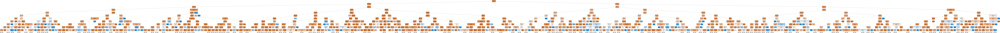

In [526]:
from sklearn.externals.six import StringIO  
from IPython.display import Image  
from sklearn.tree import export_graphviz
import pydotplus
dot_data = StringIO()
export_graphviz(clf, out_file=dot_data,  
                max_depth= 10, filled=True, rounded=True,
                special_characters=True, feature_names = attributes,class_names=['0','1'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png('diabetes.png')
Image(graph.create_png())